In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import cv2
from skimage.filters.rank import entropy
from skimage.morphology import disk
from skimage.filters import gaussian, sobel, scharr
from skimage.feature import canny
import random
import tensorflow as tf
from tensorflow.keras import utils
import pandas as pd
import seaborn as sns
import pickle
import mtcnn
from mtcnn.mtcnn import MTCNN
%matplotlib inline
from matplotlib import pyplot as plt

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.callbacks import EarlyStopping

from sklearn.metrics import confusion_matrix
import itertools

%matplotlib inline


In [2]:
def display_images(num_images, image_array, title, columns=1):
    '''This function displays images as they are, before any pre-processing.'''
    columns = columns
    rows = int(num_images / columns)
    fig, ax = plt.subplots(rows, columns, figsize=(columns*4, rows*4))
    fig.suptitle(title, size=20)
    ax = ax.ravel()
    for i in range(num_images):
        ax[i].imshow(image_array[i][0], cmap='gray')
        ax[i].set_title(label_mapping.get(image_array[i][1]), size=16)

In [3]:
def subplot_images(num_images, dataframe, image_indices, title, columns=4, target_width=224, target_height=224):
    '''This function displays images from a dataframe with specified indices, along with cropping and resizing.'''
    columns = columns
    rows = int(num_images / columns)
    fig, ax = plt.subplots(rows, columns, figsize=(columns*4, rows*4), sharex=True, sharey=True)
    fig.suptitle(title, size=20)
    ax = ax.ravel()
    for i, img_index in enumerate(image_indices):
        image = dataframe.loc[img_index, 'image_array']
        new_image = crop_and_resize(image, target_width=target_width, target_height=target_height)
        ax[i].imshow(new_image, cmap='gray')
        ax[i].set_title(dataframe.loc[img_index, 'face_shape'], size=16)

In [4]:
def subplot_image_array(num_images, image_array, title, columns=4, target_width=224, target_height=224):
    '''This function displays images from an array dataset, along with cropping and resizing.'''
    columns = columns
    rows = int(num_images / columns)
    fig, ax = plt.subplots(rows, columns, figsize=(columns*4, rows*4), sharex=True, sharey=True)
    fig.suptitle(title, size=20)
    ax = ax.ravel()
    for i, img_data in enumerate(image_array):
        image = img_data[0]
        new_image = crop_and_resize(image, target_width=target_width, target_height=target_height)
        ax[i].imshow(new_image, cmap='gray')
        ax[i].set_title(label_mapping.get(img_data[1]), size=16)

In [5]:
def print_summary(training_array, testing_array):
    print(f'\nTraining Dataset:\n')
    print(f'Shape: {training_array.shape}')
    print(f'Classes: {np.unique(training_array[:,1])}')
    print(f'Number of Images in each class: {np.bincount(training_array[:,1].astype(int))}')
    print(f'Max Pixels: {np.amax(training_array[0][0][:])}')
    print('\n--------------------------------------\n')
    print(f'\nTesting Dataset:\n')
    print(f'Shape: {testing_array.shape}')
    print(f'Classes: {np.unique(testing_array[:,1])}')
    print(f'Number of Images in each class: {np.bincount(testing_array[:,1].astype(int))}')
    print(f'Max Pixels: {np.amax(testing_array[0][0][:])}')
    print('\n--------------------------------------\n')

In [6]:
train_dir = 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/training_set'
test_dir = 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/testing_set'
categories = ['Heart','Oblong','Oval','Round','Square']

In [7]:
shape_labels = {0: 'Heart', 1: 'Oblong', 2: 'Oval', 3: 'Round', 4: 'Square'}

In [8]:
def create_data_files(directory, data_array, resize=None):
    '''This function reads images from the directory and creates training and testing datasets.'''
    data_tuples = []  # List to store tuples of image arrays and class numbers
    i = 0
    for category in categories:
        path = os.path.join(directory, category)  # Path to directory of images
        class_num = categories.index(category)  # Assigns a number to the 5 categories
        img_list = os.listdir(path)
        try:
            for img in img_list:
                img_array = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)

                # Check if img_array is not None
                if img_array is not None:
                    if resize is not None:
                        img_array = cv2.resize(img_array, resize)
                    data_tuples.append((img_array, class_num))  # Append a tuple to the list
                    i += 1
                else:
                    print(f'Error: Image {img} is None. Skipping...')
        except Exception as e:
            print(f'Error: \n Category: {category}\n Image: {img}')

        # Print progress every 200 images
        if i % 200 == 0:
            print(f"Images processed: {i} of {len(img_list) * len(categories)}")

    # Convert list of tuples to NumPy array
    data_array.extend(data_tuples)
    print("Data creation completed.")

In [9]:

training_data = []
testing_data = []

create_data_files(train_dir, training_data)
create_data_files(test_dir, testing_data)

# convert them to numpy arrays


Images processed: 200 of 1000
Images processed: 400 of 1000
Images processed: 600 of 1000
Images processed: 800 of 1000
Images processed: 1000 of 1000
Data creation completed.
Data creation completed.


In [10]:

training_data = np.asarray(training_data)
testing_data = np.asarray(testing_data)


C:\Users\Asus\AppData\Local\Temp\ipykernel_41964\2319284772.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  training_data = np.asarray(training_data)
C:\Users\Asus\AppData\Local\Temp\ipykernel_41964\2319284772.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  testing_data = np.asarray(testing_data)


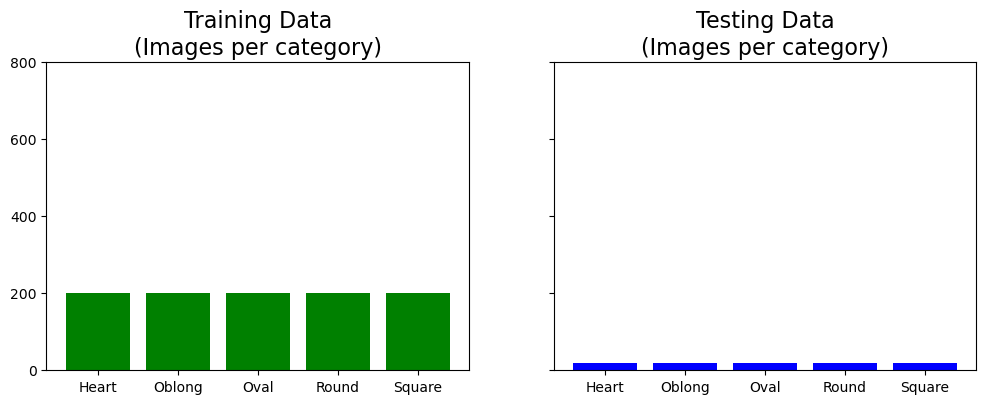

In [11]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,4),sharex=True, sharey=True)
ax[0].bar(x=categories, height = np.bincount(training_data[:,1].astype(int)),color='green')
ax[0].set_title('Training Data\n(Images per category)', size=16)
ax[1].bar(x=categories, height = np.bincount(testing_data[:,1].astype(int)),color='blue')
ax[1].set_title('Testing Data\n(Images per category)', size=16)
ax[1].set_yticks(range(0,801,200));

In [12]:
def show_img(num, img_array, title, label_map, ncols=1):
    '''this function display images as is - before any pre-processing'''
    ncols= ncols
    nrows= int(num/ncols)
    fig, ax = plt.subplots(nrows, ncols, figsize =(ncols*4,nrows*4))
    fig.suptitle(title, size = 20)
    ax = ax.ravel()
    for i in range(num):
        ax[i].imshow(img_array[i][0], cmap='gray', vmin=0, vmax=255)  # Specify vmin and vmax for grayscale images
        ax[i].set_title(label_map.get(img_array[i][1]), size=16)


In [13]:
label_map = {0: 'Heart', 1: 'Oblong', 2: 'Oval', 3: 'Round', 4: 'Square'}


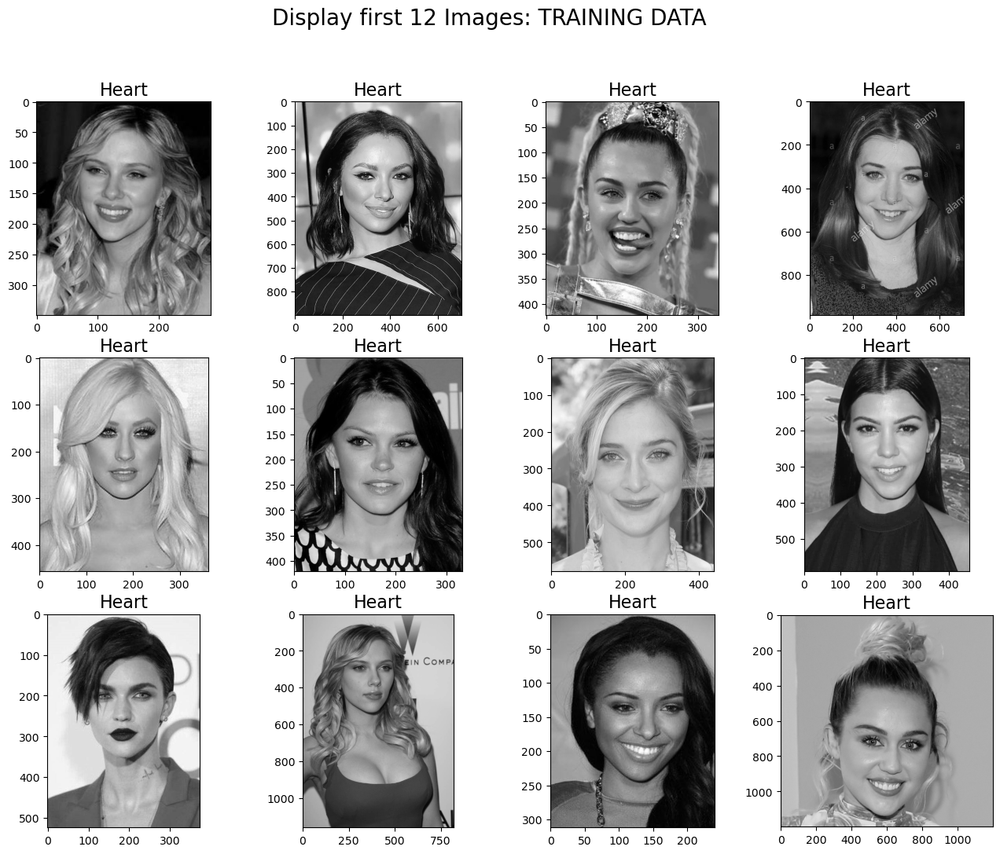

In [14]:
show_img(12, training_data[:12], 'Display first 12 Images: TRAINING DATA', label_map, ncols=4)


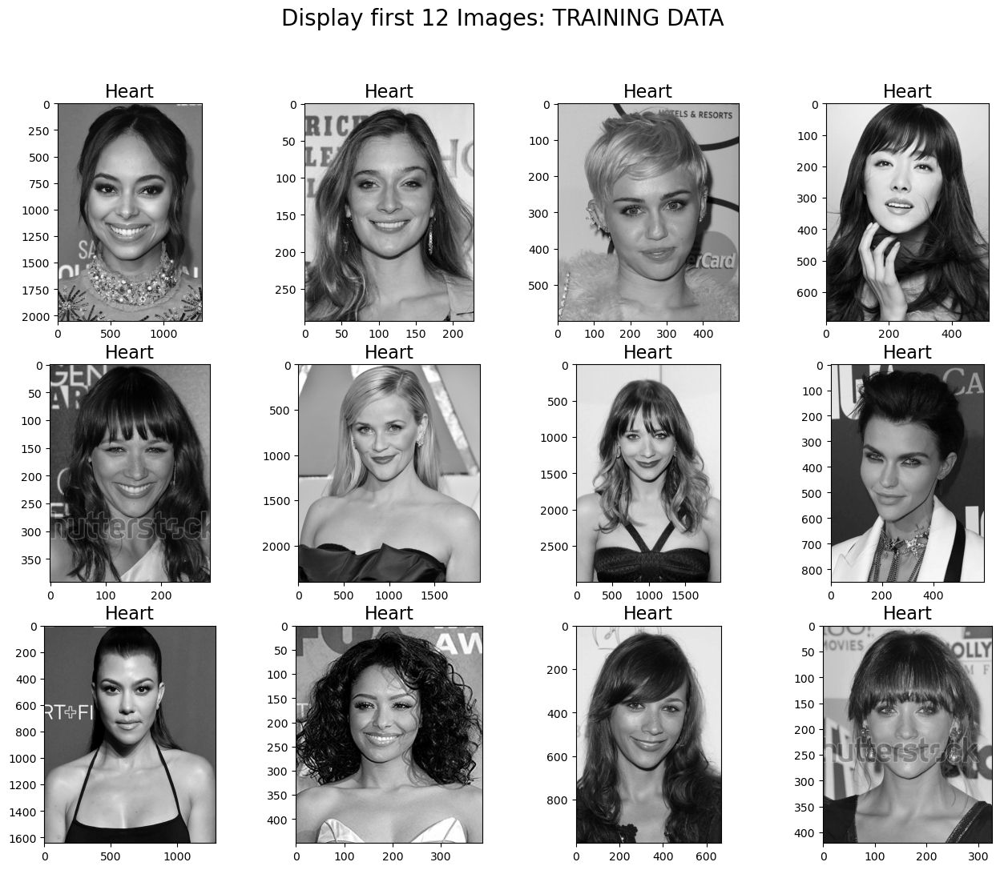

In [15]:
show_img(12, training_data[12:], 'Display first 12 Images: TRAINING DATA', label_map, ncols=4)

In [16]:
def create_data_files(directory, array, type=None):
    '''this function reads the images from the directory and create training & testing datasets'''
    i=0
    for category in categories:
        path = os.path.join(directory, category)  # path to directory of images
        class_num = categories.index(category)  # assign number to the 5 categories
        img_list = os.listdir(path)
        
        if type == 'aspect':
            try:
                for img in img_list:            
                    img_array = cv2.imread(os.path.join(path,img), cv2.IMREAD_GRAYSCALE)  # read in default color Grayscale
                    img_array = crop_and_resize(img_array) # call a function to crop & resize maintain aspect ratio
                    array.append([img_array, class_num])
                    i += 1
            except Exception as e:
                    print(f'Error: \n category: {category}\n image: {img}')
        
        elif type == 'gray':
            try:
                for img in img_list:            
                    img_array = cv2.imread(os.path.join(path,img))
                    face_array = extract_face(img_array)  # call function to extract face
                    gray_array = cv2.cvtColor(face_array,cv2.COLOR_BGR2GRAY) # convert to Gray
                    array.append([gray_array, class_num])   # 0=image, 1=class 
                    i += 1               
            except Exception as e:
                    print(f'Error: \n category: {category}\n image: {img}')

        elif type == 'rgb':
            try:
                for img in img_list:            
                    img_array = cv2.imread(os.path.join(path,img))
                    face_array = extract_face(img_array)  # call function to extract face
                    rgb_array = cv2.cvtColor(face_array,cv2.COLOR_BGR2RGB) # convert to RGB
                    array.append([rgb_array, class_num])   # 0=image, 1=class
                    i += 1                
            except Exception as e:
                    print(f'Error: \n category: {category}\n image: {img}')

        else:
            print("Please specify image type ['aspect', 'gray', 'rgb']")
            break

        # Print progress every 400 images
        if i % 200 == 0:
            print(f"Images processed: {i} of {len(img_list*len(categories))}")

In [17]:

def show_img(num, img_array, title, ncols=1):
    '''this function display images from an image array'''
    ncols= ncols
    nrows= int(num/ncols)
    fig, ax = plt.subplots(nrows, ncols, figsize =(ncols*4,nrows*4))
    fig.suptitle(title, size = 20)
    ax = ax.ravel()
    for i in range(num):
        ax[i].imshow(img_array[i][0], cmap='gray')
        ax[i].set_title(label_map.get(img_array[i][1]), size=16)

In [21]:
def train_test_prep(training_data_array, testing_data_array):
    
    # shuffle the images to mix all the 5 classes randomly
    random.shuffle(training_data_array)
    random.shuffle(testing_data_array)
    
    # read and split X_train, X_test, y_train, y_test into an array
    X_train = []
    y_train = []
    X_test = []
    y_test = []

    for features, label in training_data_array:
        X_train.append(features)
        y_train.append(label)

    for features, label in testing_data_array:
        X_test.append(features)
        y_test.append(label)

    # change data types/format for X
    X_train = np.array(X_train, dtype=float)
    X_test = np.array(X_test, dtype=float)

    X_train = X_train/255
    X_test = X_test/255

    # change values of y to categorical
    y_train = utils.to_categorical(y_train, 5)  
    y_test = utils.to_categorical(y_test, 5)

    return(X_train, X_test, y_train, y_test)

In [27]:
def crop_and_resize(image, target_w=224, target_h=224):
    '''this function crop & resize images to target size by keeping aspect ratio'''
    if image.ndim == 2:
        img_h, img_w = image.shape             # for Grayscale will be   img_h, img_w = img.shape
    elif image.ndim == 3:
        img_h, img_w, channels = image.shape   # for RGB will be   img_h, img_w, channels = img.shape
    target_aspect_ratio = target_w/target_h
    input_aspect_ratio = img_w/img_h

    if input_aspect_ratio > target_aspect_ratio:
        resize_w = int(input_aspect_ratio*target_h)
        resize_h = target_h
        img = cv2.resize(image, (resize_w , resize_h))
        crop_left = int((resize_w - target_w)/2)  ## crop left/right equally
        crop_right = crop_left + target_w
        new_img = img[:, crop_left:crop_right]
    if input_aspect_ratio < target_aspect_ratio:
        resize_w = target_w
        resize_h = int(target_w/input_aspect_ratio)
        img = cv2.resize(image, (resize_w , resize_h))
        crop_top = int((resize_h - target_h)/4)   ## crop the top by 1/4 and bottom by 3/4 -- can be changed
        crop_bottom = crop_top + target_h
        new_img = img[crop_top:crop_bottom, :]
    if input_aspect_ratio == target_aspect_ratio:
        new_img = cv2.resize(image, (target_w, target_h))

    return new_img

In [48]:
# create path to images in examples
ex_path = 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example'
ex_files = os.listdir(ex_path)

examples = []

for i in ex_files:
    img = os.path.join(ex_path, i).replace("\\", "/")
    examples.append(img)
    
examples = sorted(examples)
examples


['C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/heart (30).jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/heart (41).jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/heart (420).jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/heart (43).jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/heart (54).jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/heart (7).jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/example/landscape.jpg']

In [49]:
portrait = cv2.imread(
    'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset/example/heart (30).jpg', 
    cv2.IMREAD_GRAYSCALE)
landscape = cv2.imread(
    'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset/example/landscape.jpg',
    cv2.IMREAD_GRAYSCALE)


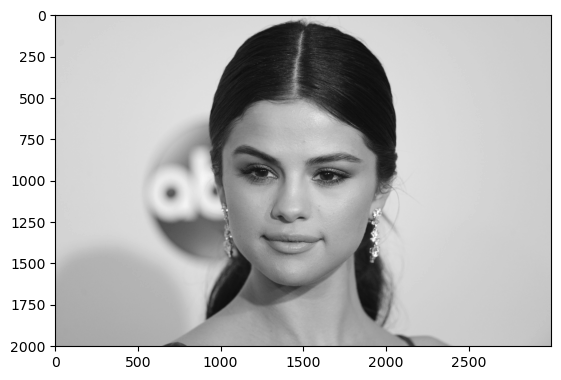

In [50]:
plt.imshow(landscape,cmap='gray')

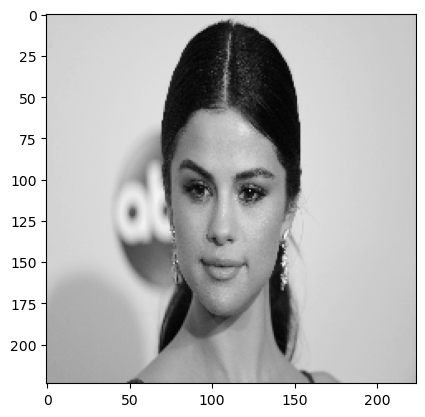

In [51]:

# auto resize by 224 - will be distorted
resized_lscp = cv2.resize(landscape,(224,224))
plt.imshow(resized_lscp, cmap='gray')

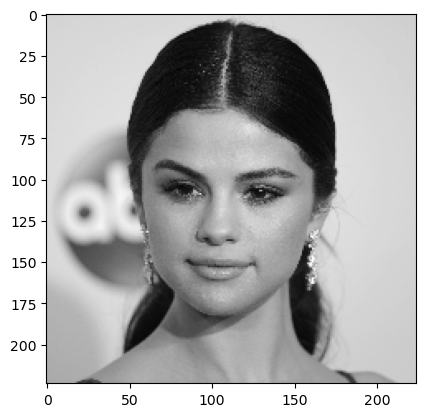

In [52]:

# test if the function works on landscape photos
new_lscp = crop_and_resize(landscape)
plt.imshow(new_lscp,cmap='gray');

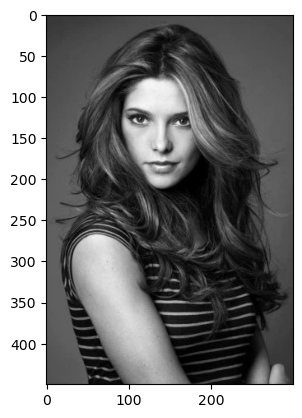

In [53]:

# original image
plt.imshow(portrait,cmap='gray');

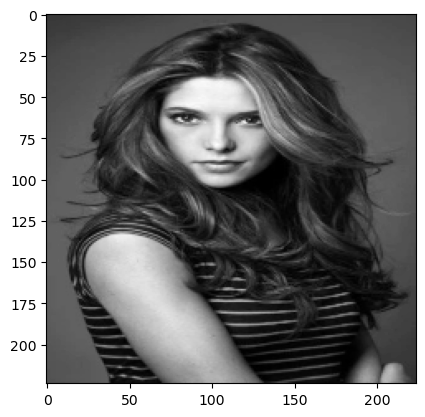

In [54]:

# auto resize by 224 - will be distorted
resized_ptrt = cv2.resize(portrait,(224,224))
plt.imshow(resized_ptrt, cmap='gray')
     

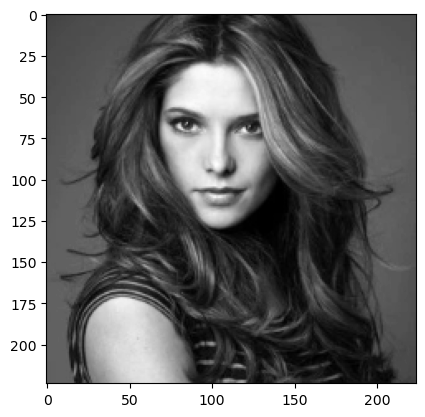

In [55]:

# test if the function works on portrait photos
new_lscp = crop_and_resize(portrait)
plt.imshow(new_lscp,cmap='gray');

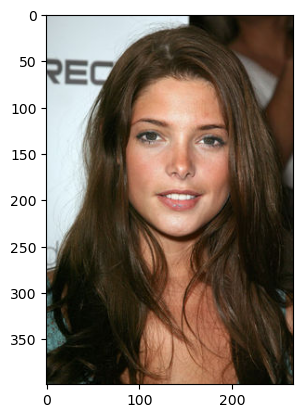

In [56]:
img = cv2.imread('C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset/example/heart (54).jpg')
img2 = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
plt.imshow(img2);

In [57]:

# creates detector
detector = MTCNN()
# detect faces in an image
results = detector.detect_faces(img2)
results

1/1 [==============================] - 0s 82ms/step


[{'box': [82, 60, 121, 175],
  'confidence': 0.9987959861755371,
  'keypoints': {'left_eye': (115, 132),
   'right_eye': (175, 135),
   'nose': (146, 169),
   'mouth_left': (116, 193),
   'mouth_right': (169, 194)}}]

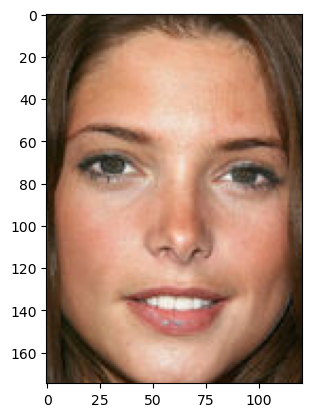

In [58]:
# extract the bounding box from the face

x1, y1, width, height = results[0]['box']
x2, y2 = x1+width, y1+height

face = img2[y1:y2, x1:x2]
plt.imshow(face);

x1 = 82
x2 = 203
y1 = 60
y2 = 235


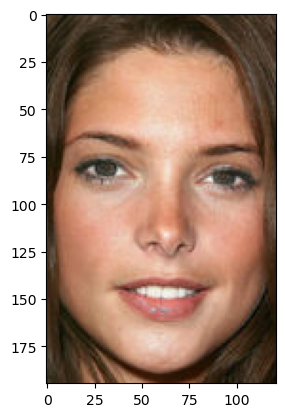

In [59]:

print(f'x1 = {x1}')
print(f'x2 = {x2}')
print(f'y1 = {y1}')
print(f'y2 = {y2}')

# first fix the heights by adding 10 pix each side
face_2 = img2[y1-10:y2+10, x1:x2];
plt.imshow(face_2);
     

h=205
w=121


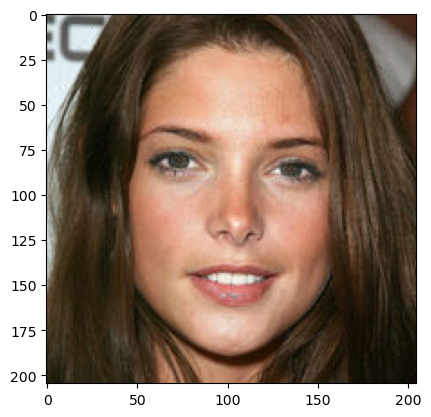

In [60]:

# then add the width to be square
h = (y2+20) - (y1-10)
w = x2-x1
print(f'h={h}')
print(f'w={w}')

adj_h = 10
adj_w = int((h-w)/2)

new_y1 = y1-adj_h
new_y2 = y2+(adj_h*2)

new_x1 = x1-adj_w
new_x2 = x2+adj_w

new_face = img2[new_y1:new_y2, new_x1:new_x2]
plt.imshow(new_face);

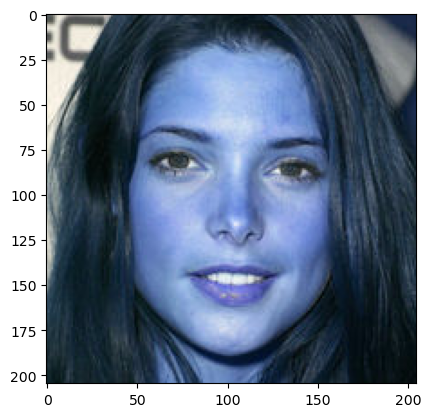

In [61]:

bgr = cv2.cvtColor(new_face,cv2.COLOR_RGB2BGR)
plt.imshow(bgr);
     

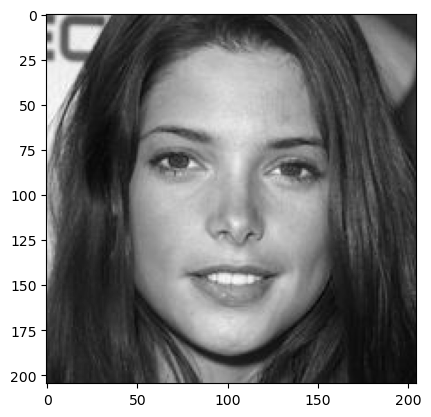

In [62]:

gray = cv2.cvtColor(new_face,cv2.COLOR_RGB2GRAY)
plt.imshow(gray,cmap='gray');

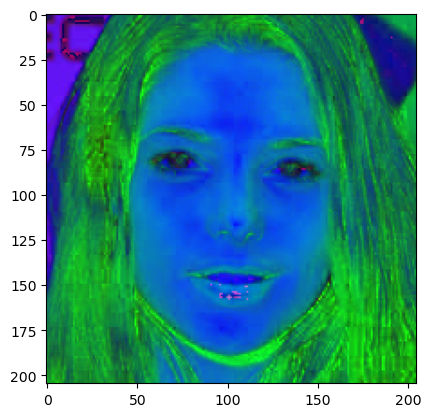

In [63]:

hsv = cv2.cvtColor(new_face,cv2.COLOR_RGB2HSV)
plt.imshow(hsv,cmap='gray');

In [64]:

entropy = entropy(gray,disk(5))
plt.imshow(entropy,cmap='gray');


TypeError: 'numpy.ndarray' object is not callable

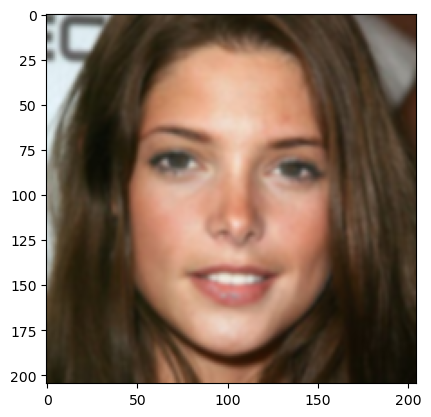

In [65]:

blur = gaussian(new_face)
plt.imshow(blur);

In [66]:
def extract_face(img, target_size=(224,224)):
    '''this functions extract face from different images by 
    1) finds the facial bounding box 
    2) slightly expands top & bottom boundaries to include the whole face
    3) crop into a square shape
    4) resize to target image size for modelling'''
           
    # 1. detect faces in an image
      
    results = detector.detect_faces(img)
    if results == []:
        new_face = crop_and_resize(img, target_w=224, target_h=224)    
    else:
        x1, y1, width, height = results[0]['box']
        x2, y2 = x1+width, y1+height
        face = img[y1:y2, x1:x2]  # this is the face image from the bounding box before expanding bbox

        # 2. expand the top & bottom of bounding box by 10 pixels to ensure it captures the whole face
        adj_h = 10

        #assign value of new y1
        if y1-adj_h <10:
            new_y1=0
        else:
            new_y1 = y1-adj_h

        #assign value of new y2    
        if y1+height+adj_h < img.shape[0]:
            new_y2 = y1+height+adj_h
        else:
            new_y2 = img.shape[0]
        new_height = new_y2 - new_y1

        # 3. crop the image to a square image by setting the width = new_height and expand the box to new width
        adj_w = int((new_height-width)/2)    

        #assign value of new x1
        if x1-adj_w < 0:
            new_x1=0
        else:
            new_x1 = x1-adj_w

        #assign value of new x2
        if x2+adj_w > img.shape[1]:
            new_x2 = img.shape[1]
        else:
            new_x2 = x2+adj_w
        new_face = img[new_y1:new_y2, new_x1:new_x2]  # face-cropped square image based on original resolution

    # 4. resize image to the target pixel size
    sqr_img = cv2.resize(new_face, target_size)   
    return sqr_img

In [67]:

def cvt_gabor(gray_img):
    ksize = 3
    sigma = 0.5
    theta = 1*np.pi/4
    lamda = 1*np.pi/4
    gamma = 0.8
    phi = 0
    
    gabor_kernel = cv2.getGaborKernel((ksize, ksize), sigma, theta, lamda, gamma, phi, ktype=cv2.CV_32F)
    gb_img = cv2.filter2D(gray_img, cv2.CV_8UC3, gabor_kernel)
    
    return(gb_img)

2/2 [==============================] - 0s 2ms/step


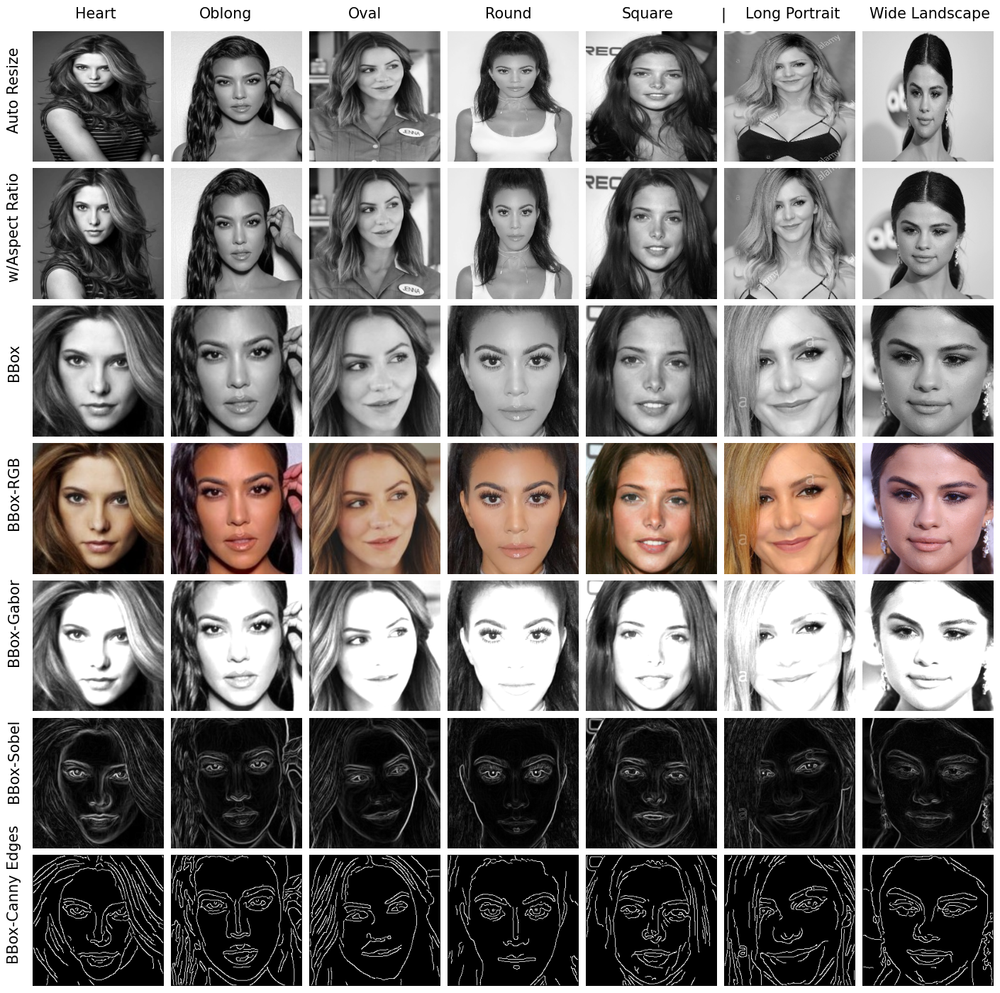

In [68]:
# test the function on the examples

n_images = len(examples)

fig, ax = plt.subplots(nrows=7, ncols=n_images, figsize=(n_images*2.5, (7*2.5)))
plt.gray()

ax= ax.ravel()

for i, file in enumerate(examples):
    
    img = cv2.imread(file)
    new_img = extract_face(img) # call function to extract face
    
    rsz_img = cv2.resize(img,(224,224))
    rsz_img = cv2.cvtColor(rsz_img,cv2.COLOR_BGR2GRAY)
    ax[i].imshow(rsz_img)
    ax[i].axis('off')
    
    aspct_img = crop_and_resize(img, target_w=224, target_h=224)
    aspct_img = cv2.cvtColor(aspct_img,cv2.COLOR_BGR2GRAY)
    ax[i+(n_images*1)].imshow(aspct_img)
    ax[i+(n_images*1)].axis('off')
    
    rgb_img = cv2.cvtColor(new_img,cv2.COLOR_BGR2RGB)
    ax[i+(n_images*3)].imshow(rgb_img)
    ax[i+(n_images*3)].axis('off')
    
    gray_img = cv2.cvtColor(new_img,cv2.COLOR_BGR2GRAY)
    ax[i+(n_images*2)].imshow(gray_img)
    ax[i+(n_images*2)].axis('off')
        
    gabor_img = cvt_gabor(gray_img)
    ax[i+(n_images*4)].imshow(gabor_img)
    ax[i+(n_images*4)].axis('off')
    
    sobel_img = sobel(gray_img)
    ax[i+(n_images*5)].imshow(sobel_img)
    ax[i+(n_images*5)].axis('off')
    
    canny_img = canny(gray_img, sigma=1.5)
    ax[i+(n_images*6)].imshow(canny_img)
    ax[i+(n_images*6)].axis('off')
    
plt.subplots_adjust(hspace=0.05, wspace=0.05)

plt.figtext(x=0.105, y=0.8, s="Auto Resize", fontsize=15, rotation=90)
plt.figtext(x=0.105, y=0.68, s="w/Aspect Ratio", fontsize=15, rotation=90)
plt.figtext(x=0.105, y=0.6, s="BBox", fontsize=15, rotation=90)
plt.figtext(x=0.105, y=0.48, s="BBox-RGB", fontsize=15, rotation=90)
plt.figtext(x=0.105, y=0.37, s="BBox-Gabor", fontsize=15, rotation=90)
plt.figtext(x=0.105, y=0.26, s="BBox-Sobel", fontsize=15, rotation=90)
plt.figtext(x=0.105, y=0.13, s="BBox-Canny Edges", fontsize=15, rotation=90)
plt.figtext(x=0.16, y=0.89, s="Heart", fontsize=15)
plt.figtext(x=0.26, y=0.89, s="Oblong", fontsize=15)
plt.figtext(x=0.38, y=0.89, s="Oval", fontsize=15)
plt.figtext(x=0.49, y=0.89, s="Round", fontsize=15)
plt.figtext(x=0.6, y=0.89, s="Square", fontsize=15)
plt.figtext(x=0.68, y=0.89, s="|", fontsize=15)
plt.figtext(x=0.7, y=0.89, s="Long Portrait", fontsize=15)
plt.figtext(x=0.8, y=0.89, s="Wide Landscape", fontsize=15);

In [69]:
def plot_results(mod_history, metric, epochs):
      
      # Check out our train loss and test loss over epochs.
      train_metric = mod_history.history[metric]
      val = 'val_' + metric
      test_metric = mod_history.history[val]

      # Set figure size.
      plt.figure(figsize=(12, 8))

      # Generate line plot of training, testing loss over epochs.
      plt.plot(train_metric, label=f'Training {metric}', color='#185fad')
      plt.plot(test_metric, label=f'Testing {metric}', color='orange')

      # Set title
      plt.title(f'Training and Testing {metric} by Epoch', fontsize = 25)
      plt.xlabel('Epoch', fontsize = 18)
      plt.ylabel('Categorical Crossentropy', fontsize = 18)
      plt.xticks(range(0,epochs,5), range(0,epochs,5))
      plt.legend(fontsize = 18);

In [70]:
def make_predictions(mod_name, steps=20):
    preds = mod_name.predict(X_test,steps=steps)
    preds = preds.argmax(axis=-1)

    y_test_labels = np.argmax(y_test, axis=-1)

    cm = confusion_matrix(y_test_labels,preds)

    plot_confusion_matrix(cm, cm_plot_labels, normalize=True,
                          title='Face Shape Normalized')


In [71]:
cm_plot_labels = ['Heart','Oblong','Oval','Round', 'Square']

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.figure(figsize=(16,8))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [96]:
def plot_summary_results(mod_name, mod_history, epochs):
    plot_results(mod_history, 'loss',epochs)
    plot_results(mod_history, 'accuracy', epochs)
    make_predictions(mod_name)

In [73]:

# create new training & testing data with resizing

training_data_apr = []
testing_data_apr = []

create_data_files(train_dir, training_data_apr, 'aspect')
create_data_files(test_dir, testing_data_apr, 'aspect')

Images processed: 200 of 1000
Images processed: 400 of 1000
Images processed: 600 of 1000
Images processed: 800 of 1000
Images processed: 1000 of 1000


In [74]:

X_train, X_test, y_train, y_test = train_test_prep(training_data_apr, testing_data_apr)

print(f'X_train.shape {X_train.shape}')
print(f'X_test.shape {X_test.shape}')
print(f'y_train.shape {y_train.shape}')
print(f'y_test.shape {y_test.shape}')

X_train.shape (1000, 224, 224)
X_test.shape (100, 224, 224)
y_train.shape (1000, 5)
y_test.shape (100, 5)


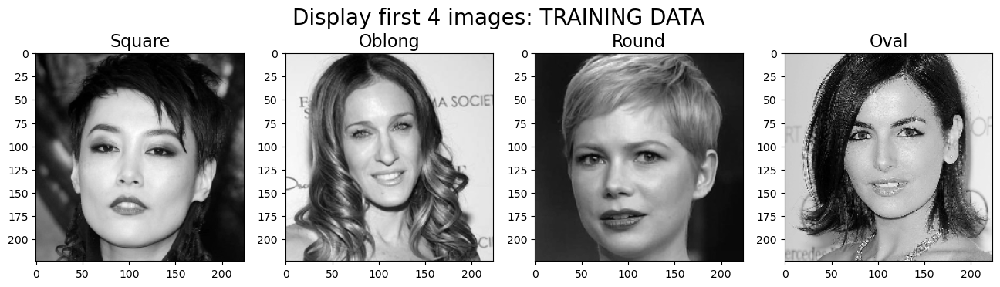

In [75]:

show_img(4, training_data_apr[:4], 'Display first 4 images: TRAINING DATA', ncols=4)

In [76]:
 #pickle_out(X_train, X_test, y_train, y_test, 'apr')

In [77]:
training_data_gray = []
testing_data_gray = []

create_data_files(train_dir, training_data_gray, 'gray')
create_data_files(test_dir, testing_data_gray, 'gray')

print(f'Training Images: {len(training_data_gray)}')
print(f'Testing Images: {len(testing_data_gray)}')

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 17ms/step
Images processed: 200 of 1000
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 24ms/step
Images processed: 400 of 1000
1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 24ms/step
Images processed: 600 of 1000
1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 29ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 103ms/step


1/1 [==============================] - 0s 33ms/step
Images processed: 800 of 1000
1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 42ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 36ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 25ms/step


1/1 [==============================] - 0s 34ms/step
Images processed: 1000 of 1000
1/1 [==============================] - 0s 43ms/step


1/1 [==============================] - 0s 40ms/step


1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 43ms/step


1/1 [==============================] - 0s 53ms/step
Training Images: 1000
Testing Images: 100


In [78]:

X_train, X_test, y_train, y_test = train_test_prep(training_data_gray, testing_data_gray)

print(f'X_train.shape {X_train.shape}')
print(f'X_test.shape {X_test.shape}')
print(f'y_train.shape {y_train.shape}')
print(f'y_test.shape {y_test.shape}')

X_train.shape (1000, 224, 224)
X_test.shape (100, 224, 224)
y_train.shape (1000, 5)
y_test.shape (100, 5)


In [79]:

X_train = np.array(X_train).reshape(-1, 224, 224, 1)
X_test = np.array(X_test).reshape(-1, 224, 224, 1)

print(f'X_train.shape {X_train.shape}')
print(f'X_test.shape {X_test.shape}')
print(f'y_train.shape {y_train.shape}')
print(f'y_test.shape {y_test.shape}')

X_train.shape (1000, 224, 224, 1)
X_test.shape (100, 224, 224, 1)
y_train.shape (1000, 5)
y_test.shape (100, 5)


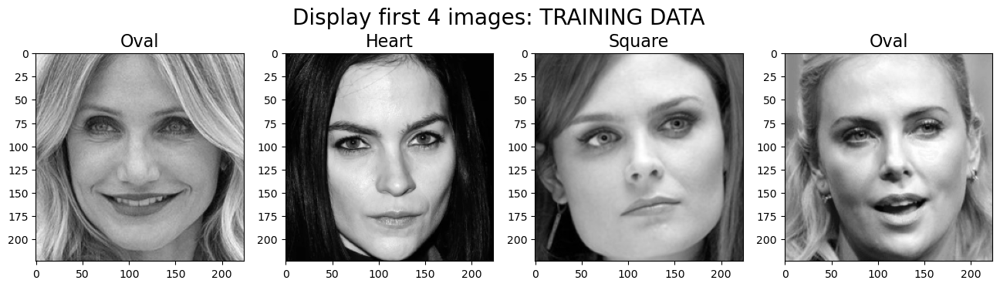

In [86]:
show_img(4, training_data_gray[4:], 'Display first 4 images: TRAINING DATA', ncols=4)

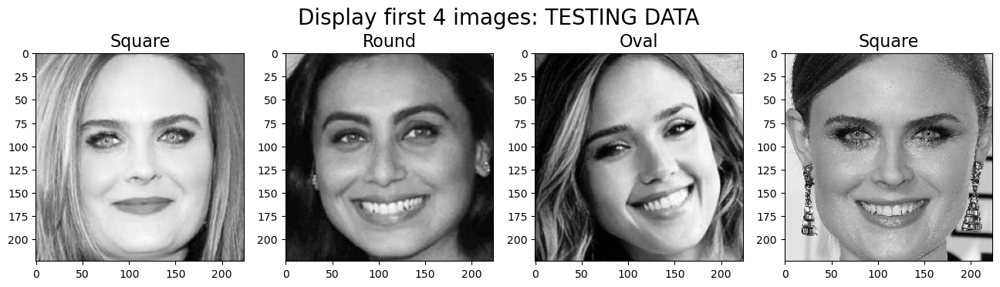

In [81]:

show_img(4, testing_data_gray[:4], 'Display first 4 images: TESTING DATA', ncols=4)

In [87]:
print("Data Summary")
print("--------------------")
print(f"X_train shape {X_train.shape}")
print(f"y_train shape {y_train.shape}")
print("--------------------")
print(f"X_test shape {X_test.shape}")
print(f"y_test shape {y_test.shape}")

Data Summary
--------------------
X_train shape (1000, 224, 224, 1)
y_train shape (1000, 5)
--------------------
X_test shape (100, 224, 224, 1)
y_test shape (100, 5)


In [88]:
model_1 = Sequential()
model_1.add(Conv2D(filters = 8,              # add this layer
                   kernel_size=3,
                   activation='relu',
                   input_shape=X_train.shape[1:]))
model_1.add(MaxPooling2D(pool_size=(2,2)))
model_1.add(Conv2D(filters = 16,              # from 64
                   kernel_size=3,
                   activation='relu'))
model_1.add(MaxPooling2D(pool_size=(2,2)))
model_1.add(Conv2D(filters = 64,             # from 128
                   kernel_size=3,
                   activation='relu'))
model_1.add(MaxPooling2D(pool_size=(2, 2)))
model_1.add(Conv2D(filters = 128,            # from 256
                   kernel_size=3,
                   activation='relu'))
model_1.add(MaxPooling2D(pool_size=(2, 2)))
model_1.add(Flatten())
model_1.add(Dense(32, activation='relu'))    # reduce from 128 to 64 to 32
model_1.add(Dropout(0.5))  ##added
model_1.add(Dense(5, activation='softmax'))

model_1.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 222, 222, 8)       80        
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 111, 111, 8)       0         
 ng2D)                                                           
                                                                 
 conv2d_25 (Conv2D)          (None, 109, 109, 16)      1168      
                                                                 
 max_pooling2d_13 (MaxPooli  (None, 54, 54, 16)        0         
 ng2D)                                                           
                                                                 
 conv2d_26 (Conv2D)          (None, 52, 52, 64)        9280      
                                                                 
 max_pooling2d_14 (MaxPooli  (None, 26, 26, 64)        0

In [90]:
history_1 = model_1.fit(X_train,
                        y_train,
                        batch_size=32,
                        epochs=100,
                        validation_data=(X_test, y_test))

Epoch 1/100
32/32 [==============================] - 42s 1s/step - loss: 1.6104 - accuracy: 0.2120 - val_loss: 1.6089 - val_accuracy: 0.2800
Epoch 2/100
32/32 [==============================] - 42s 1s/step - loss: 1.6101 - accuracy: 0.2030 - val_loss: 1.6094 - val_accuracy: 0.1700
Epoch 3/100
32/32 [==============================] - 45s 1s/step - loss: 1.6056 - accuracy: 0.2240 - val_loss: 1.6041 - val_accuracy: 0.2000
Epoch 4/100
32/32 [==============================] - 43s 1s/step - loss: 1.5965 - accuracy: 0.2250 - val_loss: 1.5998 - val_accuracy: 0.2800
Epoch 5/100
32/32 [==============================] - 43s 1s/step - loss: 1.5842 - accuracy: 0.2620 - val_loss: 1.5931 - val_accuracy: 0.2600
Epoch 6/100
32/32 [==============================] - 42s 1s/step - loss: 1.5581 - accuracy: 0.2860 - val_loss: 1.5693 - val_accuracy: 0.2400
Epoch 7/100
32/32 [==============================] - 39s 1s/step - loss: 1.5161 - accuracy: 0.3330 - val_loss: 1.5253 - val_accuracy: 0.3800
Epoch 8/100
3

Epoch 59/100
32/32 [==============================] - 37s 1s/step - loss: 0.3201 - accuracy: 0.8540 - val_loss: 3.0997 - val_accuracy: 0.5100
Epoch 60/100
32/32 [==============================] - 36s 1s/step - loss: 0.3132 - accuracy: 0.8620 - val_loss: 2.7277 - val_accuracy: 0.5200
Epoch 61/100
32/32 [==============================] - 34s 1s/step - loss: 0.3627 - accuracy: 0.8180 - val_loss: 2.7701 - val_accuracy: 0.5000
Epoch 62/100
32/32 [==============================] - 34s 1s/step - loss: 0.3293 - accuracy: 0.8350 - val_loss: 2.9054 - val_accuracy: 0.5200
Epoch 63/100
32/32 [==============================] - 35s 1s/step - loss: 0.3794 - accuracy: 0.8180 - val_loss: 2.8798 - val_accuracy: 0.5200
Epoch 64/100
32/32 [==============================] - 34s 1s/step - loss: 0.3630 - accuracy: 0.8310 - val_loss: 2.8484 - val_accuracy: 0.4700
Epoch 65/100
32/32 [==============================] - 33s 1s/step - loss: 0.3226 - accuracy: 0.8470 - val_loss: 2.7164 - val_accuracy: 0.5200
Epoch 

In [91]:
max(history_1.history['val_accuracy'])

0.5799999833106995

In [92]:
model_1.evaluate(X_test, y_test)

4/4 [==============================] - 1s 152ms/step - loss: 3.4289 - accuracy: 0.5100


[3.4288747310638428, 0.5099999904632568]

UnimplementedError: Graph execution error:

Detected at node 'sequential/conv2d_24/Relu' defined at (most recent call last):
    File "D:\ana\lib\runpy.py", line 196, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "D:\ana\lib\runpy.py", line 86, in _run_code
      exec(code, run_globals)
    File "D:\ana\lib\site-packages\ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "D:\ana\lib\site-packages\traitlets\config\application.py", line 992, in launch_instance
      app.start()
    File "D:\ana\lib\site-packages\ipykernel\kernelapp.py", line 711, in start
      self.io_loop.start()
    File "D:\ana\lib\site-packages\tornado\platform\asyncio.py", line 199, in start
      self.asyncio_loop.run_forever()
    File "D:\ana\lib\asyncio\base_events.py", line 603, in run_forever
      self._run_once()
    File "D:\ana\lib\asyncio\base_events.py", line 1906, in _run_once
      handle._run()
    File "D:\ana\lib\asyncio\events.py", line 80, in _run
      self._context.run(self._callback, *self._args)
    File "D:\ana\lib\site-packages\ipykernel\kernelbase.py", line 510, in dispatch_queue
      await self.process_one()
    File "D:\ana\lib\site-packages\ipykernel\kernelbase.py", line 499, in process_one
      await dispatch(*args)
    File "D:\ana\lib\site-packages\ipykernel\kernelbase.py", line 406, in dispatch_shell
      await result
    File "D:\ana\lib\site-packages\ipykernel\kernelbase.py", line 729, in execute_request
      reply_content = await reply_content
    File "D:\ana\lib\site-packages\ipykernel\ipkernel.py", line 411, in do_execute
      res = shell.run_cell(
    File "D:\ana\lib\site-packages\ipykernel\zmqshell.py", line 531, in run_cell
      return super().run_cell(*args, **kwargs)
    File "D:\ana\lib\site-packages\IPython\core\interactiveshell.py", line 2961, in run_cell
      result = self._run_cell(
    File "D:\ana\lib\site-packages\IPython\core\interactiveshell.py", line 3016, in _run_cell
      result = runner(coro)
    File "D:\ana\lib\site-packages\IPython\core\async_helpers.py", line 129, in _pseudo_sync_runner
      coro.send(None)
    File "D:\ana\lib\site-packages\IPython\core\interactiveshell.py", line 3221, in run_cell_async
      has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
    File "D:\ana\lib\site-packages\IPython\core\interactiveshell.py", line 3400, in run_ast_nodes
      if await self.run_code(code, result, async_=asy):
    File "D:\ana\lib\site-packages\IPython\core\interactiveshell.py", line 3460, in run_code
      exec(code_obj, self.user_global_ns, self.user_ns)
    File "C:\Users\Asus\AppData\Local\Temp\ipykernel_41964\2354341777.py", line 1, in <module>
      plot_summary_results(model_1, history_1, 100)
    File "C:\Users\Asus\AppData\Local\Temp\ipykernel_41964\3510853798.py", line 4, in plot_summary_results
      make_predictions(mod_name)
    File "C:\Users\Asus\AppData\Local\Temp\ipykernel_41964\1542921834.py", line 2, in make_predictions
      preds = mod_name.predict(X_test,steps=steps)
    File "D:\ana\lib\site-packages\keras\src\utils\traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\engine\training.py", line 2554, in predict
      tmp_batch_outputs = self.predict_function(iterator)
    File "D:\ana\lib\site-packages\keras\src\engine\training.py", line 2341, in predict_function
      return step_function(self, iterator)
    File "D:\ana\lib\site-packages\keras\src\engine\training.py", line 2327, in step_function
      outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "D:\ana\lib\site-packages\keras\src\engine\training.py", line 2315, in run_step
      outputs = model.predict_step(data)
    File "D:\ana\lib\site-packages\keras\src\engine\training.py", line 2283, in predict_step
      return self(x, training=False)
    File "D:\ana\lib\site-packages\keras\src\utils\traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\engine\training.py", line 569, in __call__
      return super().__call__(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\utils\traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\engine\base_layer.py", line 1150, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\utils\traceback_utils.py", line 96, in error_handler
      return fn(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\engine\sequential.py", line 405, in call
      return super().call(inputs, training=training, mask=mask)
    File "D:\ana\lib\site-packages\keras\src\engine\functional.py", line 512, in call
      return self._run_internal_graph(inputs, training=training, mask=mask)
    File "D:\ana\lib\site-packages\keras\src\engine\functional.py", line 669, in _run_internal_graph
      outputs = node.layer(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\utils\traceback_utils.py", line 65, in error_handler
      return fn(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\engine\base_layer.py", line 1150, in __call__
      outputs = call_fn(inputs, *args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\utils\traceback_utils.py", line 96, in error_handler
      return fn(*args, **kwargs)
    File "D:\ana\lib\site-packages\keras\src\layers\convolutional\base_conv.py", line 321, in call
      return self.activation(outputs)
    File "D:\ana\lib\site-packages\keras\src\activations.py", line 321, in relu
      return backend.relu(
    File "D:\ana\lib\site-packages\keras\src\backend.py", line 5397, in relu
      x = tf.nn.relu(x)
Node: 'sequential/conv2d_24/Relu'
Fused conv implementation does not support grouped convolutions for now.
	 [[{{node sequential/conv2d_24/Relu}}]] [Op:__inference_predict_function_1929623]

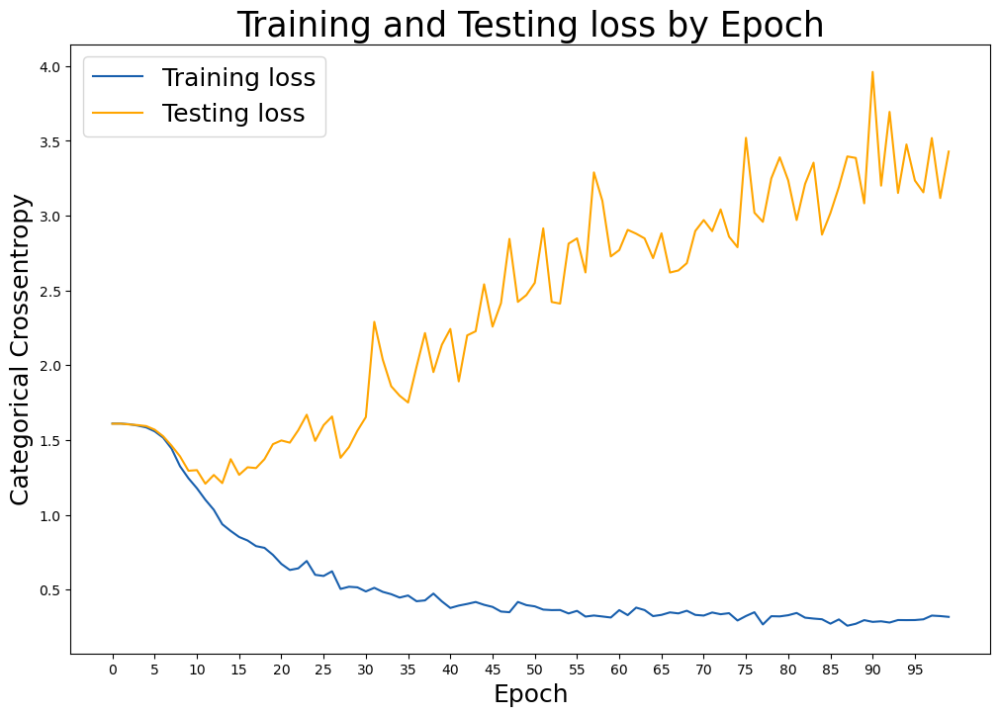

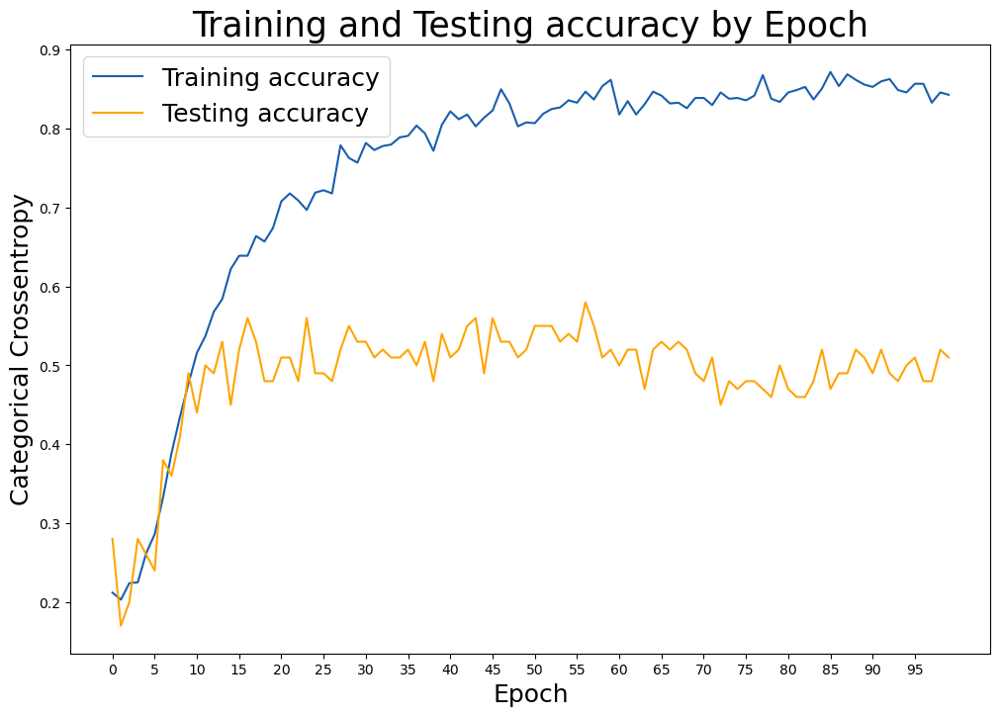

In [144]:
plot_summary_results(model_1, history_1, 100)

#will work once recreated the runtime

In [98]:
#Version RGB: Detect the face with bounding box - in RGB color

In [99]:

training_data_rgb = []
testing_data_rgb = []

create_data_files(train_dir, training_data_rgb, 'rgb')
create_data_files(test_dir, testing_data_rgb, 'rgb')

print(f'Training Images: {len(training_data_rgb)}')
print(f'Testing Images: {len(testing_data_rgb)}')

1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 54ms/step


1/1 [==============================] - 0s 50ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 24ms/step


1/1 [==============================] - 0s 47ms/step
Images processed: 200 of 1000
1/1 [==============================] - 0s 56ms/step


1/1 [==============================] - 0s 65ms/step


1/1 [==============================] - 0s 88ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 42ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 39ms/step


1/1 [==============================] - 0s 62ms/step


1/1 [==============================] - 0s 55ms/step
Images processed: 400 of 1000
1/1 [==============================] - 0s 44ms/step


1/1 [==============================] - 0s 57ms/step


1/1 [==============================] - 0s 61ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 54ms/step


1/1 [==============================] - 0s 34ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 50ms/step
Images processed: 600 of 1000
1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 30ms/step


1/1 [==============================] - 0s 72ms/step


1/1 [==============================] - 0s 36ms/step


1/1 [==============================] - 0s 64ms/step


1/1 [==============================] - 0s 32ms/step


1/1 [==============================] - 0s 33ms/step


1/1 [==============================] - 0s 82ms/step
Images processed: 800 of 1000
1/1 [==============================] - 0s 44ms/step


1/1 [==============================] - 0s 54ms/step


1/1 [==============================] - 0s 61ms/step


2/2 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 69ms/step


1/1 [==============================] - 0s 37ms/step


1/1 [==============================] - 0s 51ms/step


1/1 [==============================] - 0s 92ms/step


1/1 [==============================] - 0s 60ms/step


1/1 [==============================] - 0s 78ms/step
Images processed: 1000 of 1000
1/1 [==============================] - 0s 54ms/step


1/1 [==============================] - 0s 39ms/step


1/1 [==============================] - 0s 329ms/step


1/1 [==============================] - 0s 101ms/step
Training Images: 1000
Testing Images: 100


In [131]:
X_train, X_test, y_train, y_test = train_test_prep(training_data_rgb, testing_data_rgb)

In [133]:
print(f'X_train.shape {X_train.shape}')
print(f'X_test.shape {X_test.shape}')
print(f'y_train.shape {y_train.shape}')
print(f'y_test.shape {y_test.shape}')

X_train.shape (1000, 224, 224, 3)
X_test.shape (100, 224, 224, 3)
y_train.shape (1000, 5)
y_test.shape (100, 5)


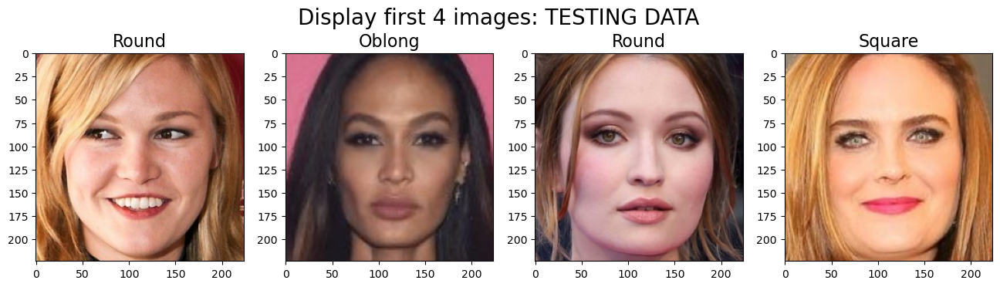

In [128]:
show_img(4, testing_data_rgb[:4], 'Display first 4 images: TESTING DATA', ncols=4)

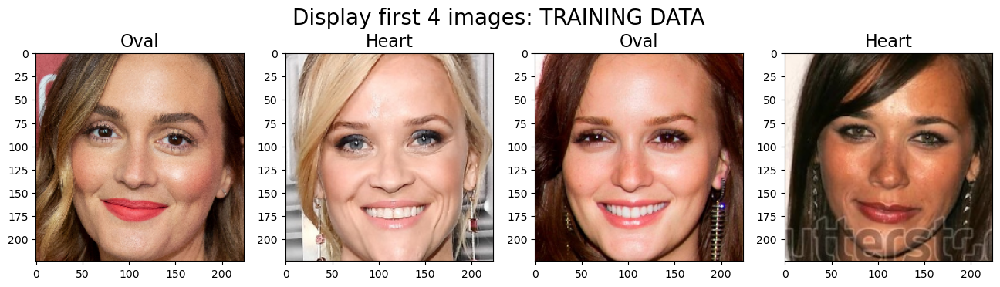

In [129]:
show_img(4, training_data_rgb[:4], 'Display first 4 images: TRAINING DATA', ncols=4)

In [134]:
print("Data Summary")
print("--------------------")
print(f"X_train2 shape {X_train.shape}")
print(f"y_train2 shape {y_train.shape}")
print("--------------------")
print(f"X_test2 shape {X_test.shape}")
print(f"y_test2 shape {y_test.shape}")

Data Summary
--------------------
X_train2 shape (1000, 224, 224, 3)
y_train2 shape (1000, 5)
--------------------
X_test2 shape (100, 224, 224, 3)
y_test2 shape (100, 5)


In [135]:
model_2 = Sequential()
model_2.add(Conv2D(filters = 8,              # add this layer
                   kernel_size=3,
                   activation='relu',
                   input_shape=X_train.shape[1:]))
model_2.add(MaxPooling2D(pool_size=(2,2)))
model_2.add(Conv2D(filters = 16,              # from 64
                   kernel_size=3,
                   activation='relu'))
model_2.add(MaxPooling2D(pool_size=(2,2)))
model_2.add(Conv2D(filters = 64,             # from 128
                   kernel_size=3,
                   activation='relu'))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(Conv2D(filters = 128,            # from 256
                   kernel_size=3,
                   activation='relu'))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(Flatten())
model_2.add(Dense(32, activation='relu'))    # reduce from 128 to 64 to 32
model_2.add(Dropout(0.5))  ##added
model_2.add(Dense(5, activation='softmax'))

model_2.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

model_2.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_64 (Conv2D)          (None, 222, 222, 8)       224       
                                                                 
 max_pooling2d_52 (MaxPooli  (None, 111, 111, 8)       0         
 ng2D)                                                           
                                                                 
 conv2d_65 (Conv2D)          (None, 109, 109, 16)      1168      
                                                                 
 max_pooling2d_53 (MaxPooli  (None, 54, 54, 16)        0         
 ng2D)                                                           
                                                                 
 conv2d_66 (Conv2D)          (None, 52, 52, 64)        9280      
                                                                 
 max_pooling2d_54 (MaxPooli  (None, 26, 26, 64)      

In [136]:
history_2 = model_2.fit(X_train,
                        y_train,
                        batch_size=32,
                        epochs=100,
                        validation_data=(X_test, y_test)) #,
                        #callbacks=[early_stop])


Epoch 1/100
32/32 [==============================] - 87s 3s/step - loss: 1.6194 - accuracy: 0.1900 - val_loss: 1.6091 - val_accuracy: 0.2100
Epoch 2/100
32/32 [==============================] - 82s 3s/step - loss: 1.6104 - accuracy: 0.1920 - val_loss: 1.6089 - val_accuracy: 0.2100
Epoch 3/100
32/32 [==============================] - 80s 3s/step - loss: 1.6090 - accuracy: 0.1980 - val_loss: 1.6032 - val_accuracy: 0.2100
Epoch 4/100
32/32 [==============================] - 80s 3s/step - loss: 1.6061 - accuracy: 0.2050 - val_loss: 1.6086 - val_accuracy: 0.2000
Epoch 5/100
32/32 [==============================] - 81s 3s/step - loss: 1.6094 - accuracy: 0.2190 - val_loss: 1.6077 - val_accuracy: 0.3000
Epoch 6/100
32/32 [==============================] - 76s 2s/step - loss: 1.6037 - accuracy: 0.2410 - val_loss: 1.6013 - val_accuracy: 0.2200
Epoch 7/100
32/32 [==============================] - 76s 2s/step - loss: 1.5794 - accuracy: 0.2740 - val_loss: 1.5969 - val_accuracy: 0.2700
Epoch 8/100
3

Epoch 59/100
32/32 [==============================] - 72s 2s/step - loss: 0.8017 - accuracy: 0.5940 - val_loss: 1.9257 - val_accuracy: 0.4700
Epoch 60/100
32/32 [==============================] - 72s 2s/step - loss: 0.8234 - accuracy: 0.5830 - val_loss: 1.7409 - val_accuracy: 0.5700
Epoch 61/100
32/32 [==============================] - 72s 2s/step - loss: 0.7847 - accuracy: 0.6350 - val_loss: 1.5970 - val_accuracy: 0.5300
Epoch 62/100
32/32 [==============================] - 72s 2s/step - loss: 0.8084 - accuracy: 0.6030 - val_loss: 1.6171 - val_accuracy: 0.5400
Epoch 63/100
32/32 [==============================] - 72s 2s/step - loss: 0.7190 - accuracy: 0.6400 - val_loss: 1.7732 - val_accuracy: 0.5100
Epoch 64/100
32/32 [==============================] - 71s 2s/step - loss: 0.7383 - accuracy: 0.6220 - val_loss: 1.7220 - val_accuracy: 0.5500
Epoch 65/100
32/32 [==============================] - 72s 2s/step - loss: 0.7362 - accuracy: 0.6300 - val_loss: 1.8715 - val_accuracy: 0.5900
Epoch 

In [137]:
model_2.evaluate(X_test, y_test)

4/4 [==============================] - 1s 302ms/step - loss: 2.2022 - accuracy: 0.6000


[2.2021939754486084, 0.6000000238418579]

In [140]:
model_2.evaluate(X_test, y_test)

4/4 [==============================] - 1s 307ms/step - loss: 2.2022 - accuracy: 0.6000


[2.2021939754486084, 0.6000000238418579]

20/20 [==============================] - 2s 87ms/step
Normalized confusion matrix
[[0.55 0.15 0.25 0.   0.05]
 [0.3  0.45 0.1  0.05 0.1 ]
 [0.3  0.1  0.5  0.05 0.05]
 [0.1  0.   0.15 0.7  0.05]
 [0.05 0.05 0.1  0.   0.8 ]]


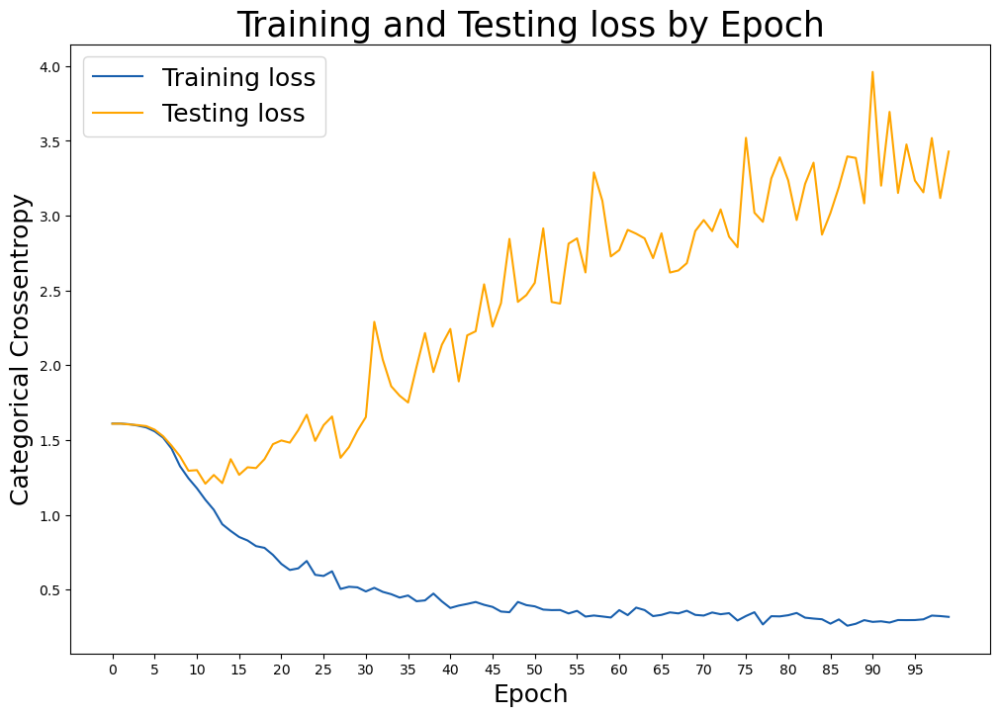

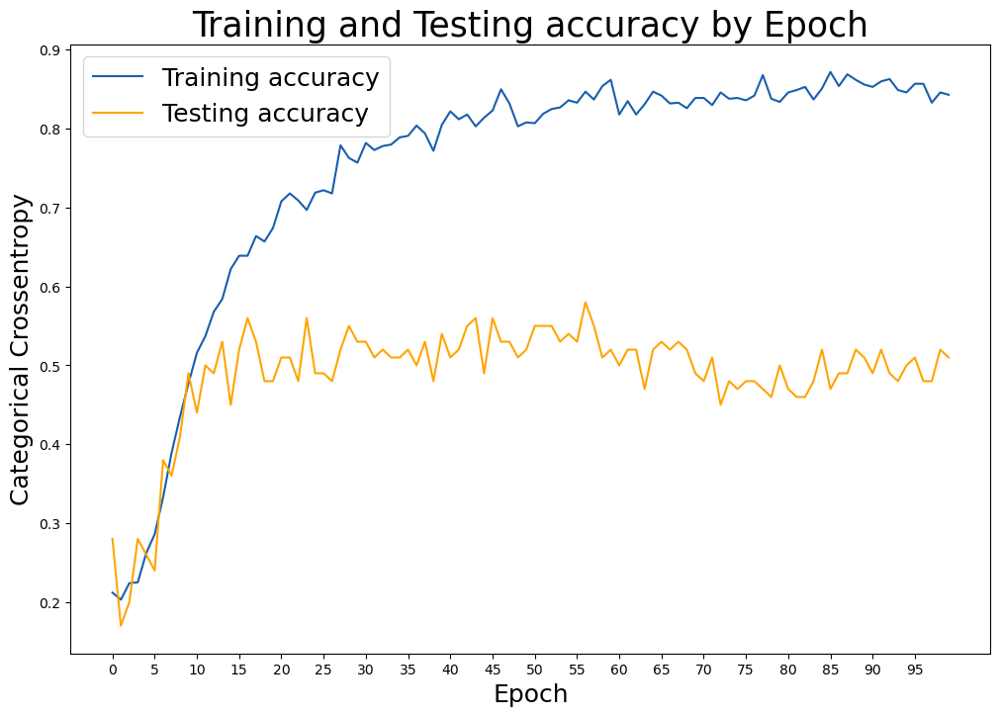

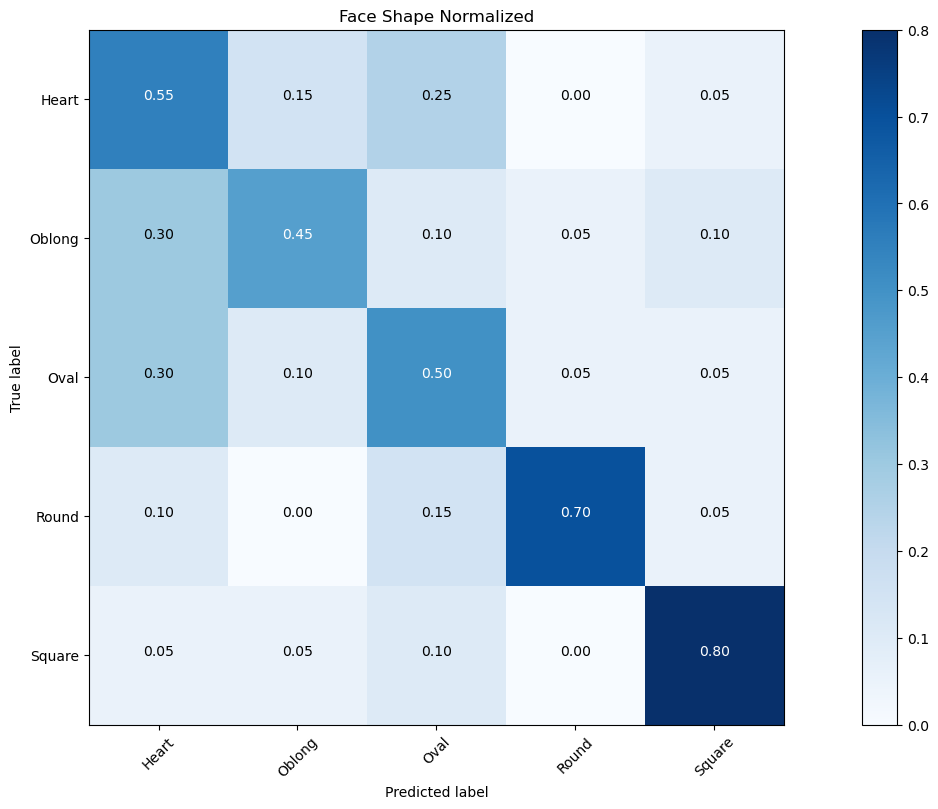

In [143]:
plot_summary_results(model_2, history_1, 100)

In [146]:
#predictions

In [147]:
y_actual = np.argmax(y_test, axis=-1)
y_predict = np.argmax(model_2.predict(X_test), axis=1)

4/4 [==============================] - 2s 321ms/step


In [150]:
def create_df(y_actual, y_predict, predict_proba, X_test, y_test):
  '''this function creates a dataframe with predictions and probabilities of a model'''
  # generate predictions

  actual = pd.DataFrame(y_actual, columns=['y_actual'])
  predict = pd.DataFrame(y_predict, columns=['y_predict'])

  # generate prediction probabilities 

  probability_list = []
  for i, item in enumerate(predict_proba):
    probabilities = {}
    probabilities['heart'] = round(item[0] * 100,2)
    probabilities['oblong'] = round(item[1] * 100,2)
    probabilities['oval'] = round(item[2] *100,2)
    probabilities['round'] = round(item[3] *100,2)
    probabilities['square'] = round(item[4] *100,2)
    probability_list.append(probabilities)
  proba = pd.DataFrame(probability_list)

  # create dataframe
  df = pd.concat([actual, predict, proba],axis=1)
  
  return df

In [152]:
predict_proba = model_2.predict(X_test)

4/4 [==============================] - 1s 301ms/step


In [154]:
missclass = create_df(y_actual, y_predict, predict_proba, X_test, y_test)
missclass.head()

,y_actual,y_predict,heart,oblong,oval,round,square
0,1,1,5.79,89.41,0.68,2.66,1.46
1,3,3,32.47,0.00,26.76,40.77,0.00
2,3,3,0.01,0.00,1.32,93.86,4.81
3,4,4,0.01,0.01,1.76,0.06,98.16
4,3,2,0.51,0.00,99.49,0.00,0.00


In [179]:
y_label_dict = {0: 'heart', 1: 'oblong', 2: 'oval', 3: 'round', 4: 'square'}

In [194]:
def plot_misclass_img_proba(df, list_index):
  for i in list_index:
    img = X_test[i] * 255
    img = np.asarray(img, int)
    label = y_label_dict[y_actual[i]]

    plt.figure(figsize=(15,5))
    plt.subplot(1,3,1)
    plt.imshow(img, cmap='gray')
    plt.title(label, size=16)
    plt.subplot(1,3,2)
    df.loc[i, ['heart', 'oblong', 'oval', 'round','square']].plot(kind='bar', color='lightgreen')
    plt.title('Probabilities - CNN ', fontsize=14, y=1.01)

In [191]:
wrong= missclass[(missclass.y_actual != missclass.y_predict) ]

In [192]:
wrong.head()

,y_actual,y_predict,heart,oblong,oval,round,square
4,3,2,0.51,0.00,99.49,0.00,0.00
5,3,0,68.68,0.05,31.16,0.11,0.00
6,2,1,11.99,85.68,1.75,0.05,0.52
9,2,0,91.82,0.00,8.18,0.00,0.00
11,0,2,6.01,9.66,73.23,0.01,11.09


C:\Users\Asus\AppData\Local\Temp\ipykernel_41964\958023781.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15,5))


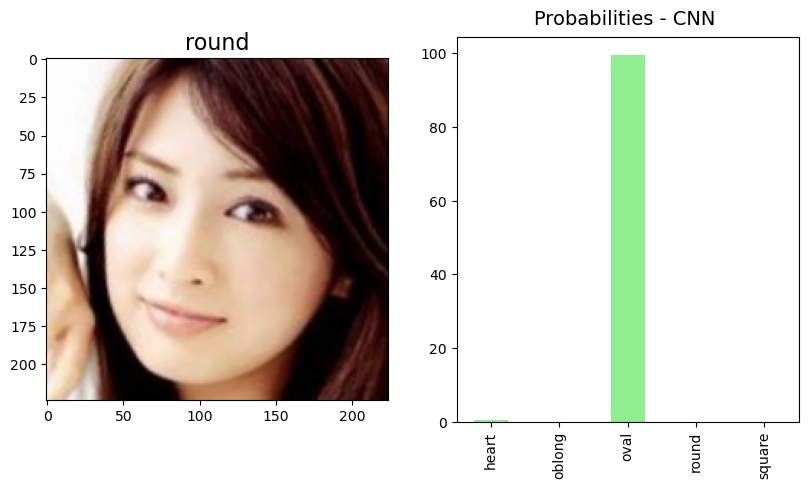

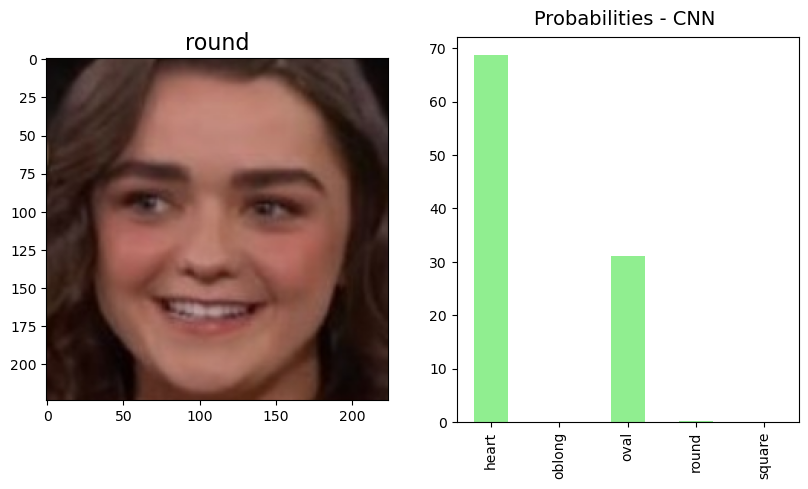

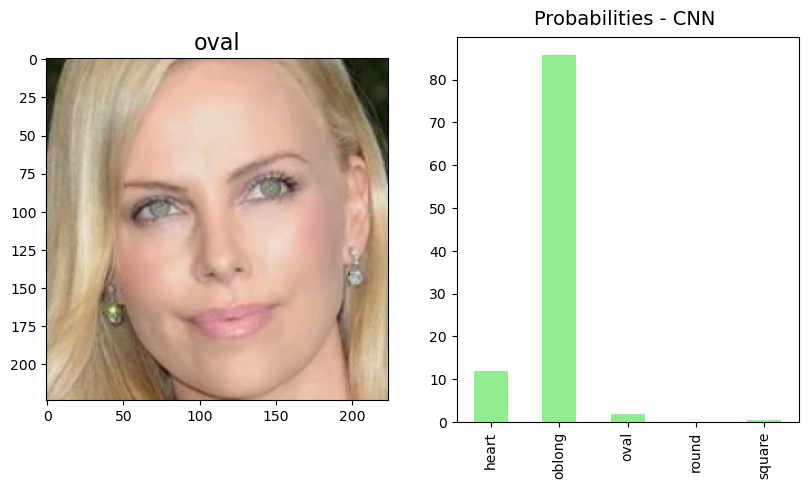

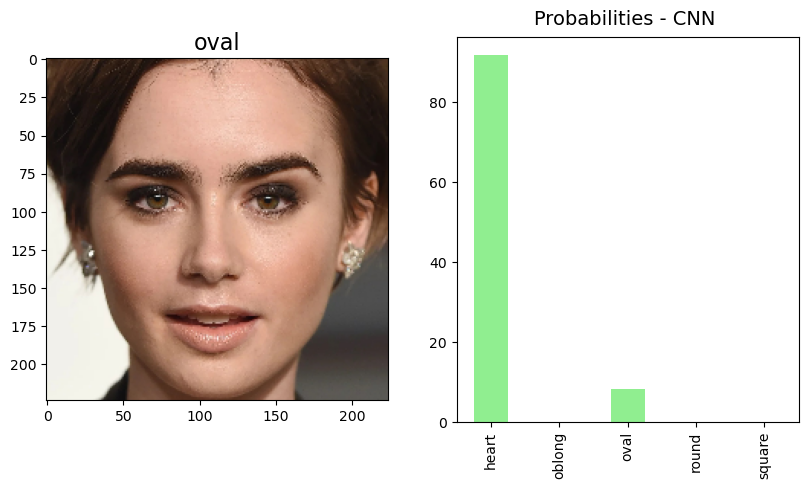

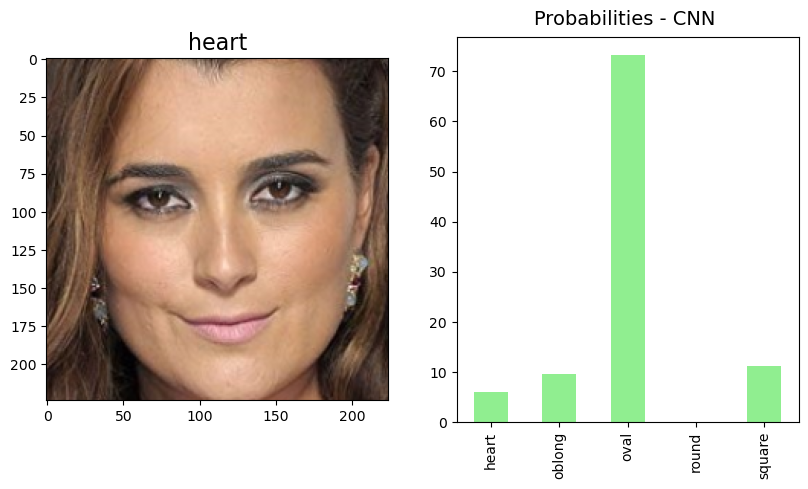

...

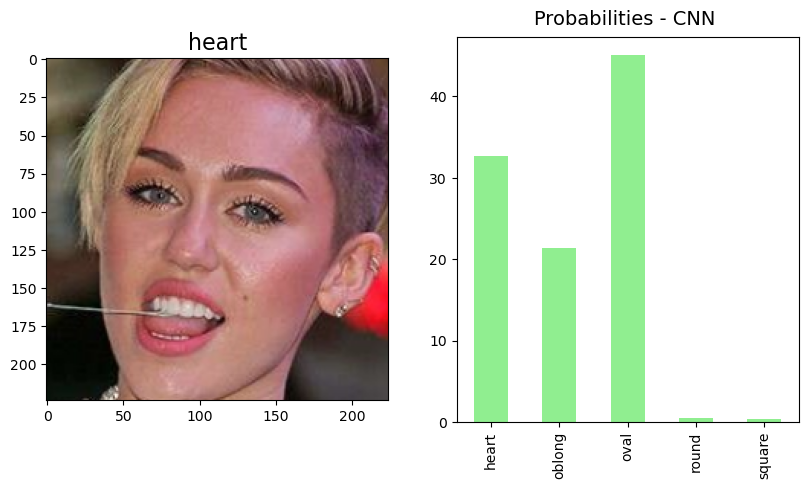

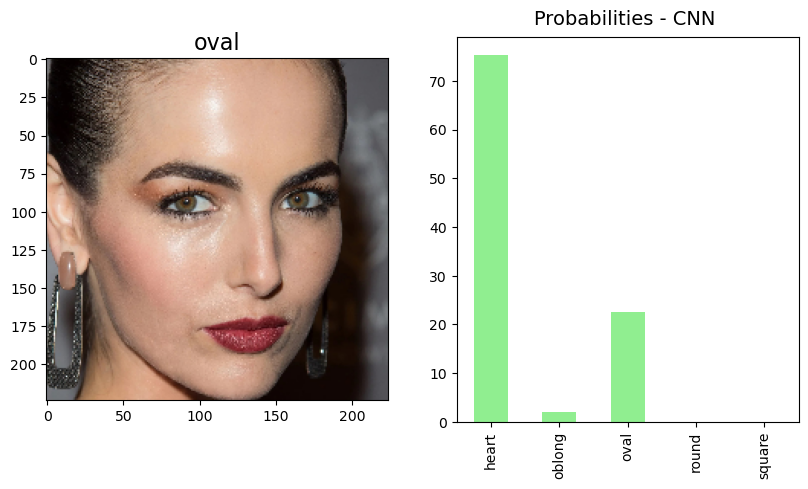

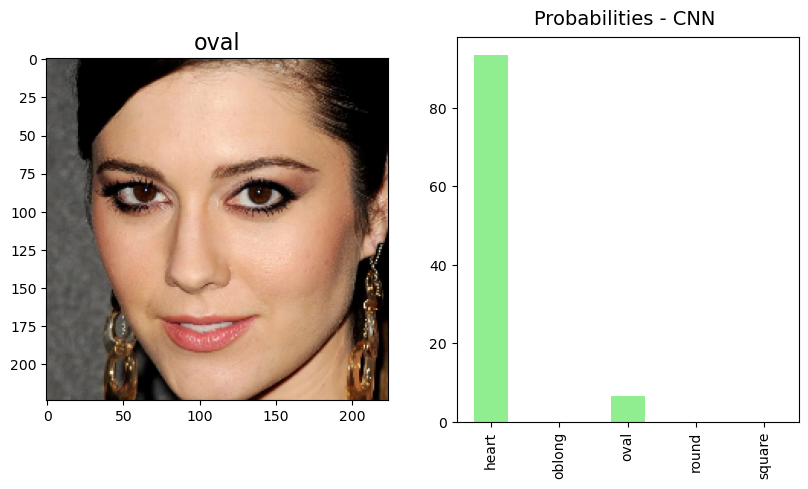

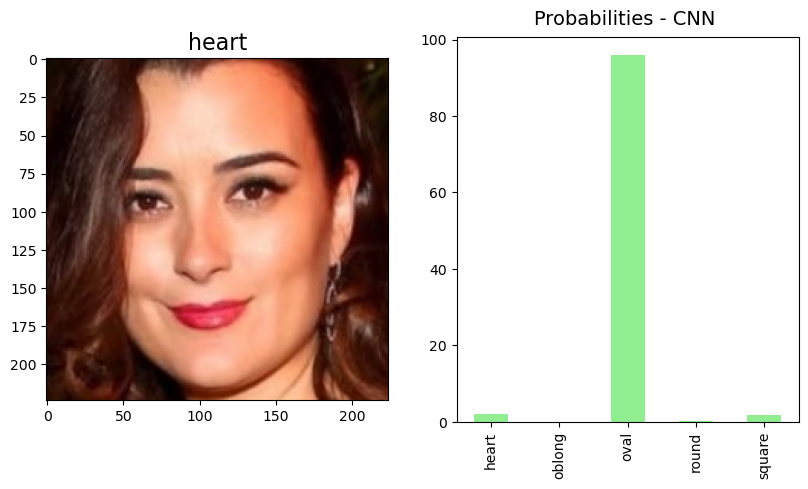

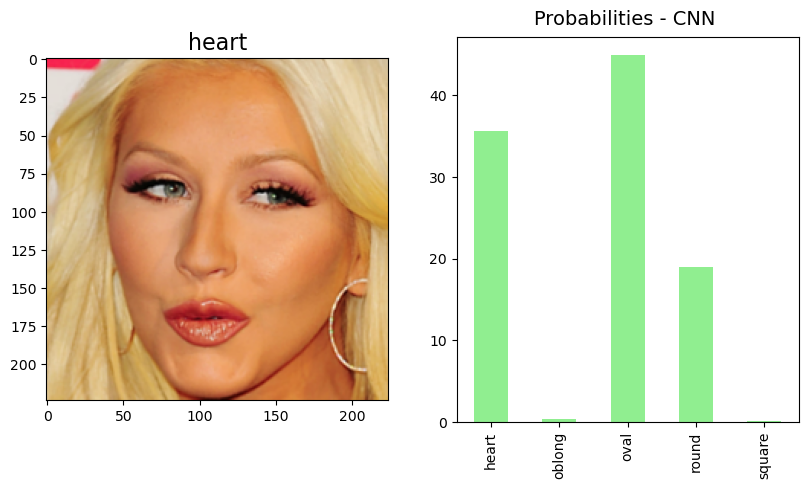

In [195]:
wrong_index = wrong.head(30).index
plot_misclass_img_proba(wrong.head(30), wrong_index)

In [223]:
y_label_dict = {0: 'Heart', 1: 'Oblong', 2: 'Oval', 3: 'Round', 4: 'Square'}
def predict_face_shape(img_array):
    '''
    this function reads a single image in the form of an array, 
    and process the image then make predictions.
    '''
    try:
        # first extract the face using bounding box
        face_img = extract_face(img_array)  # call function to extract face with bounding box
        new_img = cv2.cvtColor(face_img,cv2.COLOR_BGR2RGB) # convert to RGB -- use this for display          
        # convert the image for modelling
        test_img = np.array(new_img, dtype=float)
        test_img = test_img/255
        test_img = np.array(test_img).reshape(1, 224, 224, 3)  
        # make predictions
        pred = model_2.predict(test_img)        
        label = np.argmax(pred,axis=1)
        shape = y_label_dict[label[0]]
        print(f'Your face shape is {shape}')
        pred = np.max(pred)
        print(f'Probability {np.around(pred*100,2)}')
        plt.imshow(new_img)
    except Exception as e:
        print(f'Oops!  Something went wrong.  Please try again.')

In [301]:
import os

test_path = 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic'
test_files = os.listdir(test_path)

test_img = []

for i in test_files:
    img = os.path.join(test_path, i).replace("\\", "/")
    test_img.append(img)
    
test_img


['C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic/1516245457627.jpeg.jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic/IMG_0604.JPG',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic/WhatsApp Image 2024-04-04 at 02.03.38_441962c3.jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic/WhatsApp Image 2024-04-04 at 02.04.14_f29096c0.jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic/WhatsApp Image 2024-04-04 at 02.11.22_76de8076.jpg',
 'C:/Users/Asus/Python files fr/SEM 6/FaceShape/FaceShape Dataset smol/prediction_dic/WhatsApp Image 2024-04-04 at 02.11.22_f14a8094.jpg']

In [302]:
image_list = []
for i, file in enumerate(test_img):
  image_list.append(cv2.imread(os.path.join(test_path,file)))
len(image_list)


6

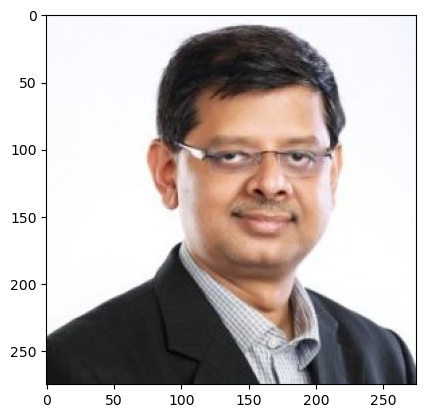

In [303]:
plt.imshow(cv2.cvtColor(image_list[0],cv2.COLOR_BGR2RGB));

1/1 [==============================] - 0s 54ms/step
Your face shape is Square
Probability 98.54


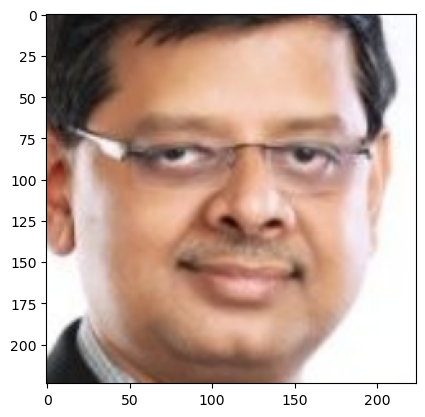

In [304]:
predict_face_shape(image_list[0])

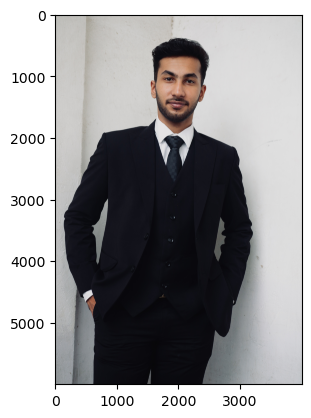

In [305]:
plt.imshow(cv2.cvtColor(image_list[1],cv2.COLOR_BGR2RGB));

1/1 [==============================] - 0s 57ms/step
Your face shape is Heart
Probability 85.56


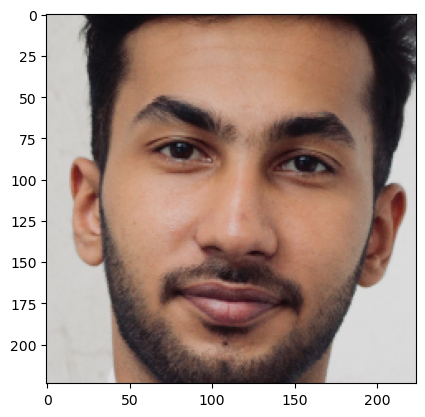

In [306]:
predict_face_shape(image_list[1])

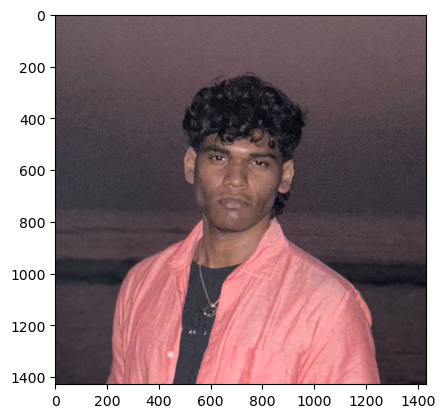

In [307]:
plt.imshow(cv2.cvtColor(image_list[2],cv2.COLOR_BGR2RGB));

1/1 [==============================] - 0s 105ms/step
Your face shape is Round
Probability 44.24


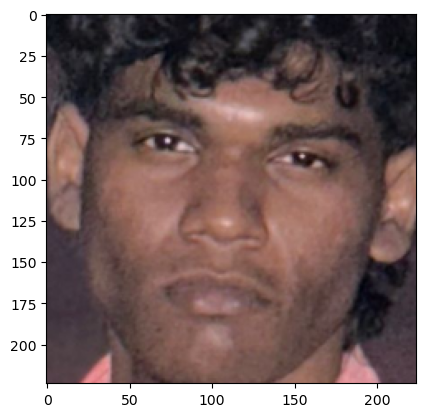

In [308]:
predict_face_shape(image_list[2])

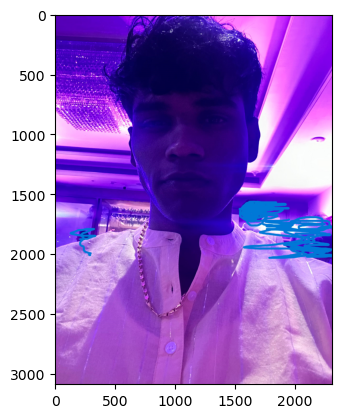

In [309]:
plt.imshow(cv2.cvtColor(image_list[3],cv2.COLOR_BGR2RGB));

1/1 [==============================] - 0s 80ms/step
Your face shape is Round
Probability 44.24


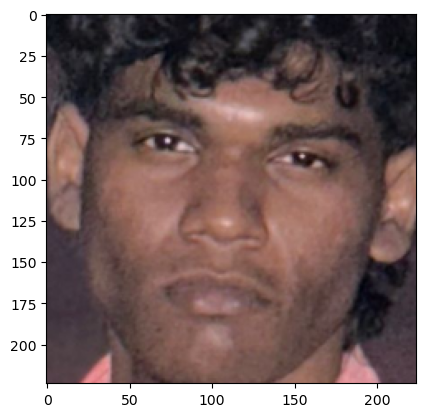

In [310]:
predict_face_shape(image_list[2])

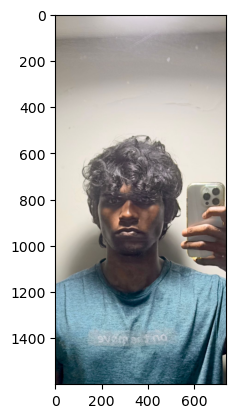

In [311]:
plt.imshow(cv2.cvtColor(image_list[4],cv2.COLOR_BGR2RGB));

1/1 [==============================] - 0s 64ms/step
Your face shape is Round
Probability 71.88


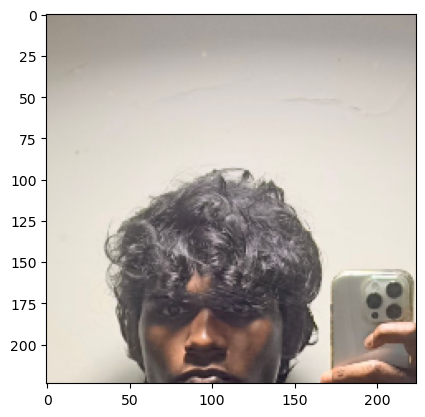

In [312]:
predict_face_shape(image_list[4])

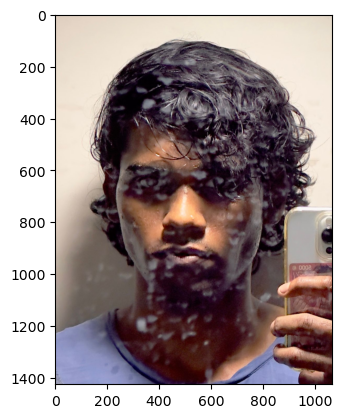

In [313]:
plt.imshow(cv2.cvtColor(image_list[5],cv2.COLOR_BGR2RGB));

1/1 [==============================] - 0s 75ms/step
Your face shape is Heart
Probability 98.33


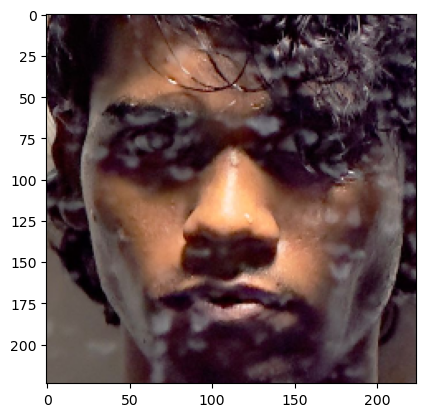

In [314]:
predict_face_shape(image_list[5])

In [ ]:
def recommend_hairstyle1(face_shape, hair_length, hair_color, hair_texture, style_preference):
    # Placeholder for recommended hairstyle names
    recommended_hairstyles = []
    
    # Implement logic to recommend hairstyles based on inputs
    if face_shape == 'Oval':
        if hair_length == 'Short':
            recommended_hairstyles = ['Pixie Cut', 'Bob Cut', 'Shaggy Pixie']
        elif hair_length == 'Medium':
            recommended_hairstyles = ['Layered Hair', 'Wavy Lob', 'Long Bob']
        else:
            recommended_hairstyles = ['Long Layers', 'Beach Waves', 'Messy Bun']
    elif face_shape == 'Round':
        if hair_length == 'Short':
            recommended_hairstyles = ['Asymmetrical Bob', 'Side-Swept Bangs', 'Choppy Pixie']
        elif hair_length == 'Medium':
            recommended_hairstyles = ['Layered Hair', 'Shoulder-Length Cut', 'Textured Lob']
        else:
            recommended_hairstyles = ['Long Layers', 'Beach Waves', 'Face-Framing Layers']
    # Add recommendations for other face shapes
    elif face_shape == 'Heart':
        if hair_length == 'Short':
            recommended_hairstyles = ['Textured Pixie', 'Layered Bob', 'Short Shag']
        elif hair_length == 'Medium':
            recommended_hairstyles = ['Side-Swept Bangs', 'Chin-Length Bob', 'Soft Layers']
        else:
            recommended_hairstyles = ['Long Side Swept Bangs', 'Layered Waves', 'Beachy Waves']
    elif face_shape == 'Square':
        if hair_length == 'Short':
            recommended_hairstyles = ['Textured Crop', 'Short Bob', 'Angular Fringe']
        elif hair_length == 'Medium':
            recommended_hairstyles = ['Choppy Layers', 'Shoulder-Length Bob', 'Textured Lob']
        else:
            recommended_hairstyles = ['Long Layers with Soft Waves', 'Classic Bob', 'Layered Curls']
    # Add more conditions based on different face shapes and hair preferences
    
    return recommended_hairstyles

In [ ]:
def predict_face_shape1(img_array):
    try:
        # Extract face from image
        face_img = extract_face(img_array)
        new_img = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)
        
        # Convert image for modeling
        test_img = np.array(new_img, dtype=float) / 255
        test_img = np.array(test_img).reshape(1, 224, 224, 3)
        
        # Make predictions for face shape
        pred = model_2.predict(test_img)
        label = np.argmax(pred, axis=1)
        face_shape = y_label_dict[label[0]]
        
        # Take additional inputs from the user
        hair_length = input("Enter hair length (Short/Medium/Long): ")
        hair_color = input("Enter hair color: ")
        hair_texture = input("Enter hair texture (Straight/Wavy/Curly): ")
        style_preference = input("Enter style preference (Casual/Formal/Party): ")
        
        # Recommend hairstyles based on inputs
        recommended_hairstyles = recommend_hairstyle1(face_shape, hair_length, hair_color, hair_texture, style_preference)
        
        # Display face shape and recommended hairstyles
        print(f'Your face shape is {face_shape}')
        plt.imshow(new_img)
        plt.show()
        
        # Display recommended hairstyles
        print("Recommended Hairstyles:")
        for i, hairstyle in enumerate(recommended_hairstyles):
            print(f"{i+1}. {hairstyle}")
        
    except Exception as e:
        print(f'Oops! Something went wrong. Please try again.')

In [ ]:
predict_face_shape1(cv2.imread(test_img[5]))